In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [ ]:
# Required plotting setting
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')
#plt.style.use('default')

import seaborn as sns
_font_size = 7.5
sns.set_context("paper", rc={"font.size":_font_size,"axes.titlesize":_font_size+1,"axes.labelsize":_font_size})   

# 2. Load data

In [ ]:
merlin_output_master_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human'
merlin_output_folders = [
    os.path.join(merlin_output_master_folder, r'20221023-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221025-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221026-hM1_hM1'),
]

In [4]:
adata_list = []
for _data_folder in merlin_output_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    # load postanalysis h5ad
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
# merge
merged_adata = anndata.concat(adata_list, )

C:\Users\puzheng_new\AppData\Local\Temp\57\ipykernel_24396\1437533028.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng_new\AppData\Local\Temp\57\ipykernel_24396\1437533028.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng_new\AppData\Local\Temp\57\ipykernel_24396\1437533028.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dty

In [7]:
figure_folder = os.path.join(merlin_output_master_folder, 'hM1_hM1-Cx28_summary')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

sc.settings.figdir = figure_folder

Create figure_folder: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1-Cx28_summary


# 3. Preprocess and filter the MERFISH data 

In [8]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

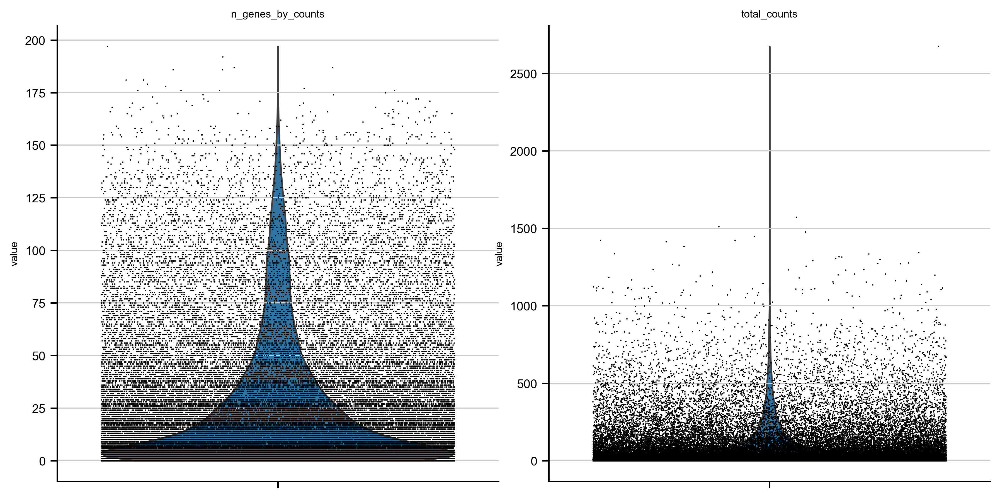

In [9]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_before_filter.png')

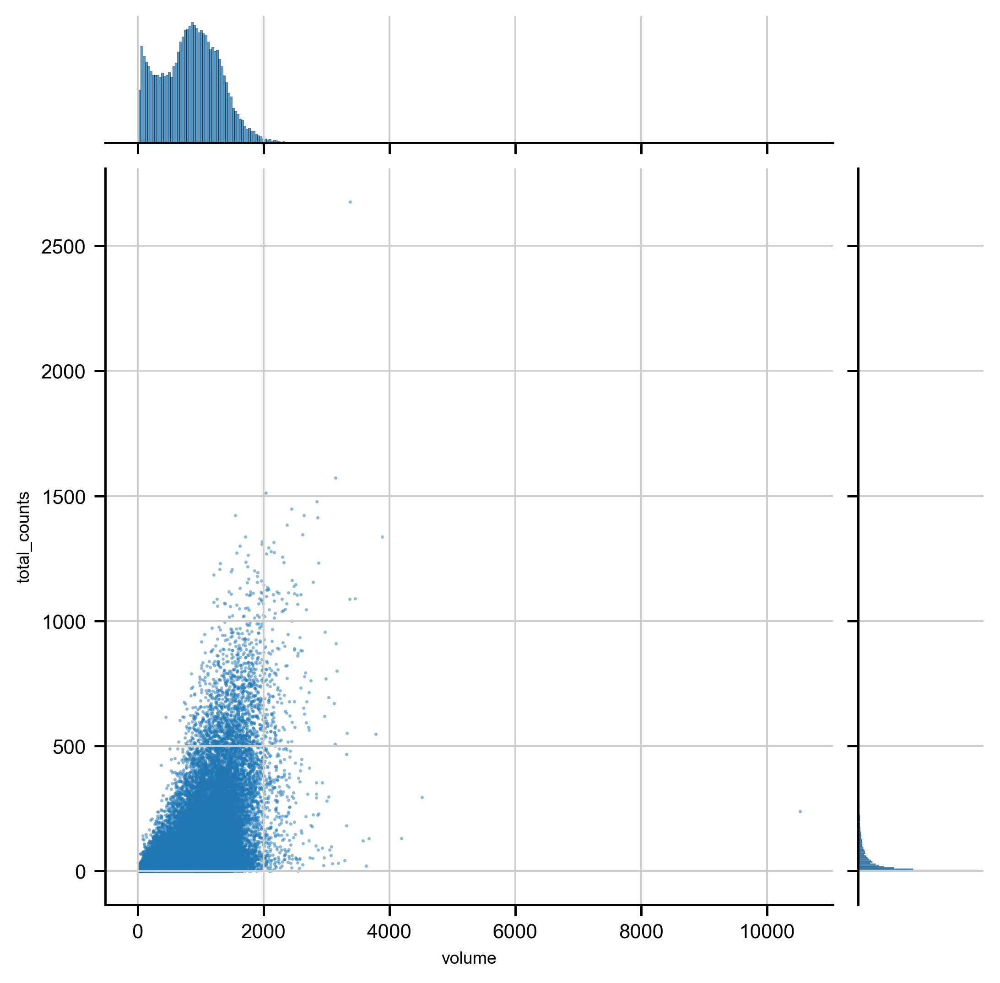

In [10]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts', s=2, linewidth=0, alpha=0.5)

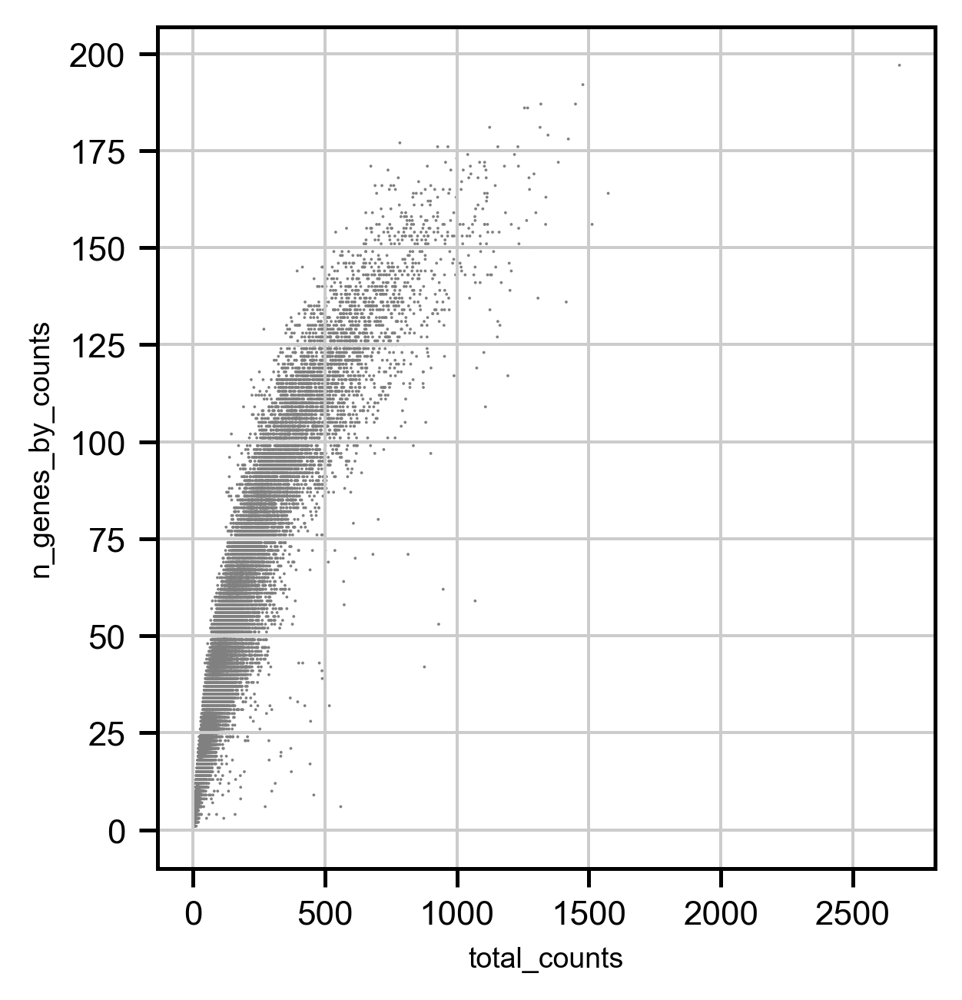

In [11]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [12]:
gene_count_threshold = 5
total_count_threshold = 10
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

33658


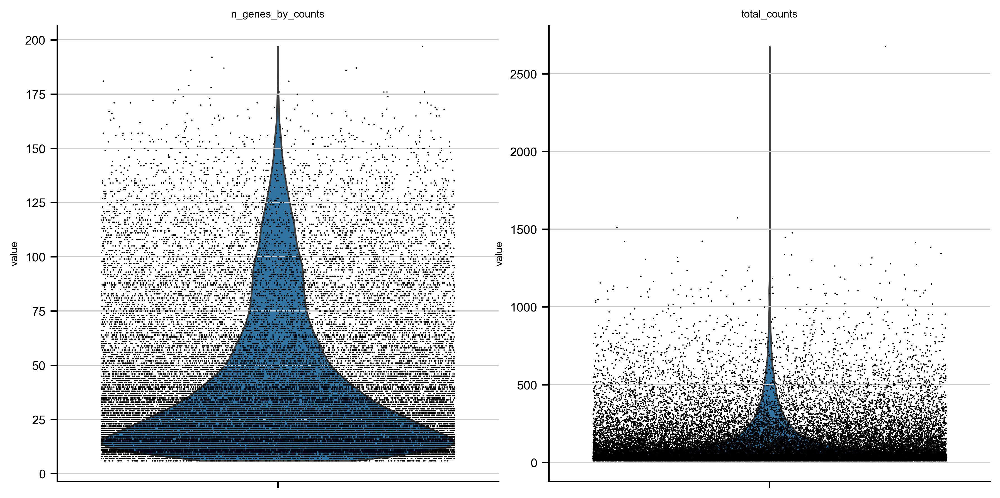

In [13]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_after_filter.png')

In [14]:
np.mean(merged_adata.obs['total_counts']), np.median(merged_adata.obs['total_counts'])

(131.41030883789062, 65.0)

## filter doublet

In [15]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.63
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\external\pp\_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


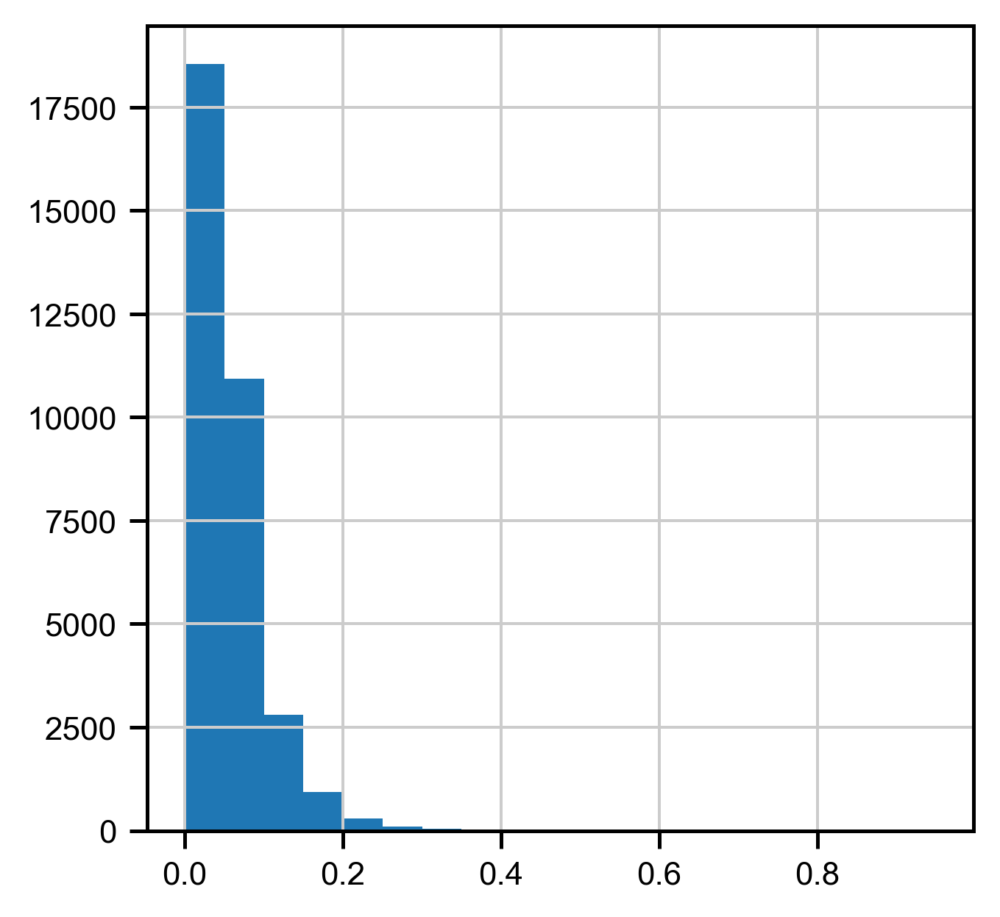

0.013399488977360508

In [17]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.2)

In [18]:
# remove potential doublet
doublet_score_th = 0.2
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

33207

# 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


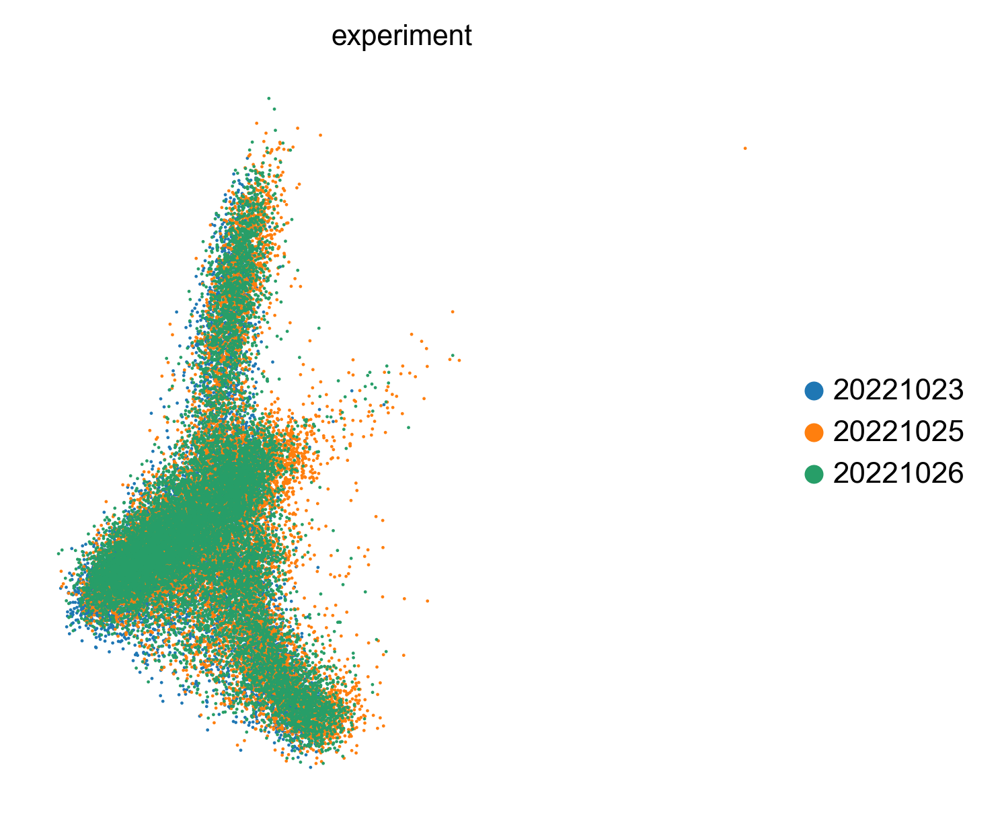

Wall time: 14.8 s


In [19]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata, color='experiment', save='_all_cells.png')

In [20]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=5, n_pcs=30)
# Clustering
sc.tl.leiden(merged_adata, resolution=0.8)

Wall time: 35.5 s


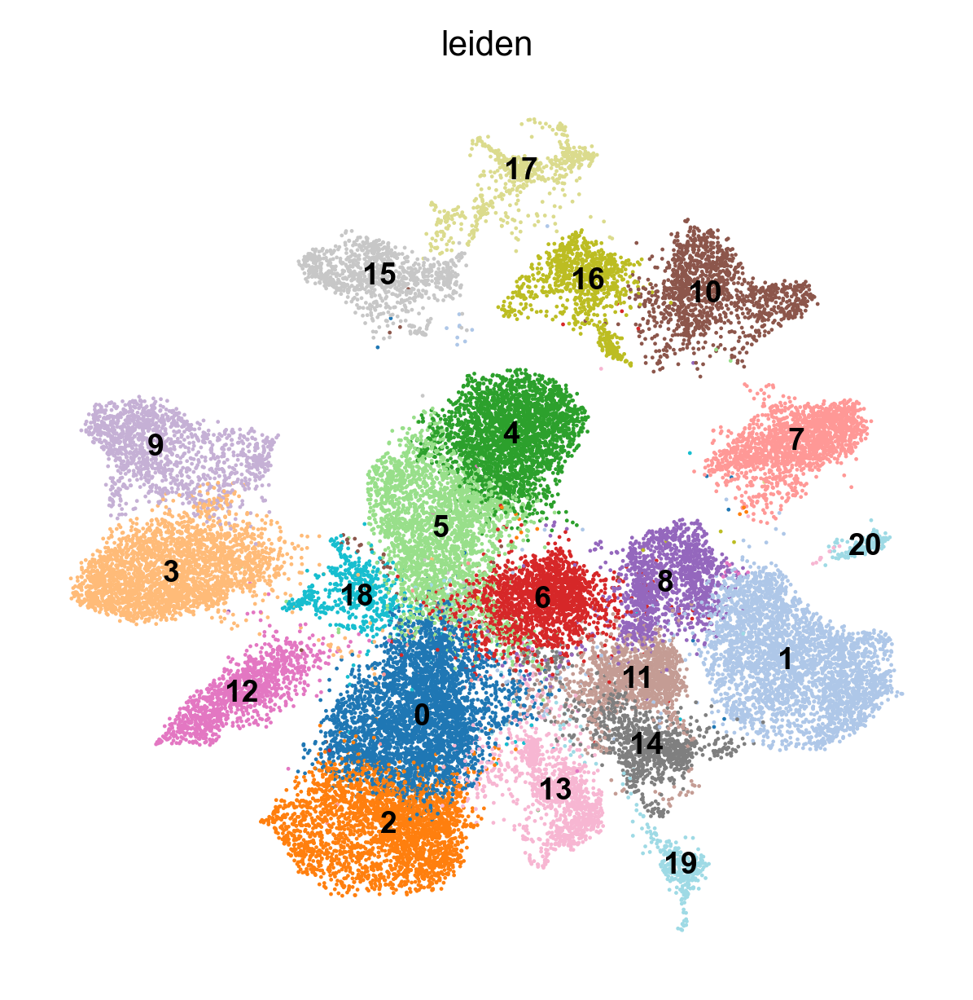

Wall time: 45.6 s


In [21]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', 
           legend_loc='on data',
           palette='tab20',
           save='_cluster.png',
           )

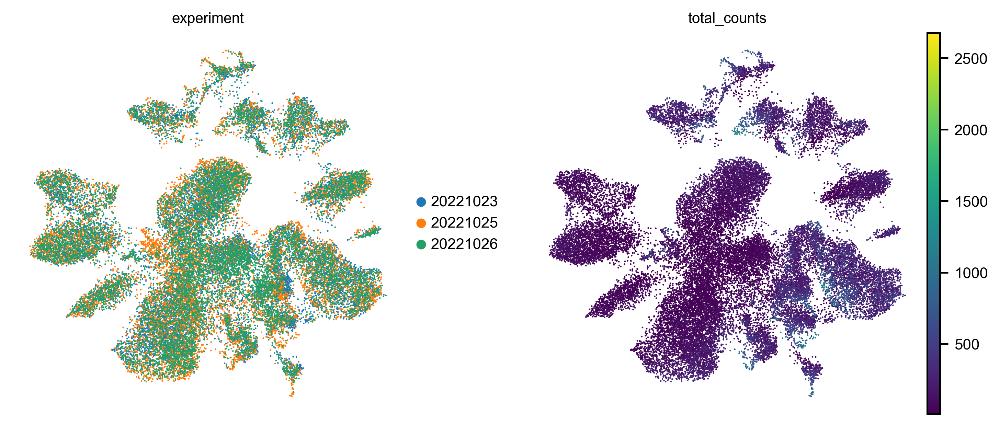

In [22]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'total_counts'], 
           save='_experiment_counts.png',)

# 5. Check count for each cell for genes of interest

In [23]:
# direcly use previous leiden
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

## T-test to identify marker genes

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

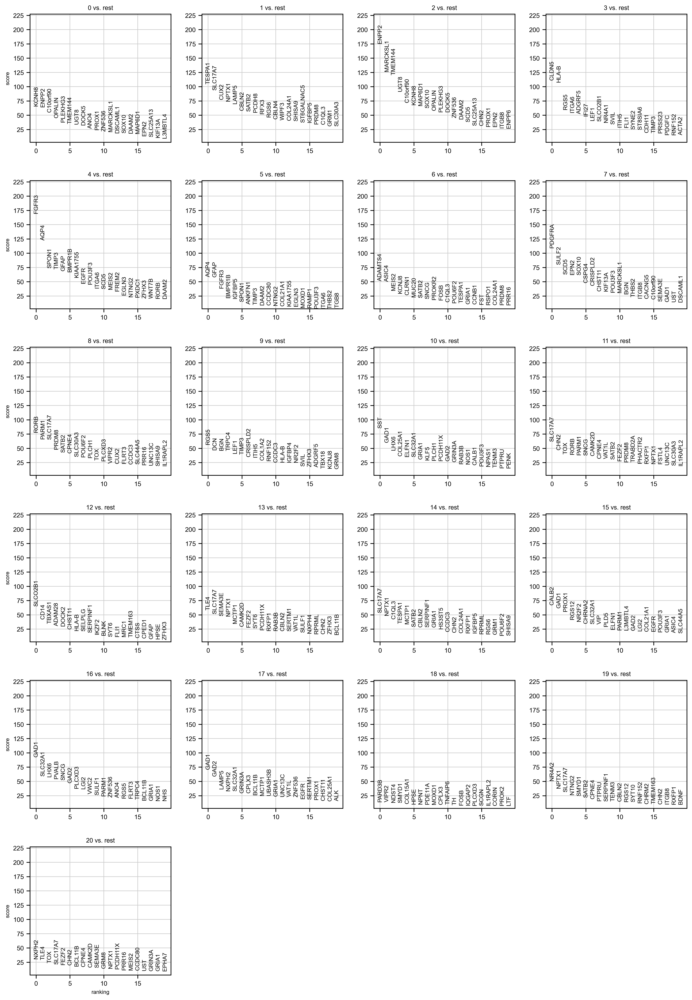

In [24]:
sc.tl.rank_genes_groups(merged_adata, groupby='leiden_cluster', method='t-test')
sc.pl.rank_genes_groups(merged_adata, groupby='leiden_cluster')

In [25]:
gene_ordering = np.array([list(_gnames) for _gnames in merged_adata.uns['rank_genes_groups']['names']])

In [26]:
# assign clusters
clusters = np.sort(np.unique(merged_adata.obs['leiden_cluster']).astype(np.int32))

# Inhibitory
inhibitory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='GAD1')[0] < 10:
        print(_i, end=', ')
        inhibitory_clusters.append(_i)
# excitatory
print("")
excitatory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='SLC17A7')[0] < 10:
        print(_i, end=', ')
        excitatory_clusters.append(_i)
nonneuron_clusters = []
for _i in clusters:
    if _i not in inhibitory_clusters and _i not in excitatory_clusters:
        nonneuron_clusters.append(_i)

10, 15, 16, 17, 
1, 8, 11, 13, 14, 19, 20, 

In [27]:
n_nonneu = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in [0]:#nonneuron_clusters:
        n_nonneu += 1

print(n_nonneu / len(merged_adata.obs))
        

0.11003704038305176


In [28]:
n_gluta = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in excitatory_clusters:
        n_gluta += 1

print(n_gluta / len(merged_adata.obs))
        

0.25654229529918393


In [29]:
len(merged_adata.obs)

33207

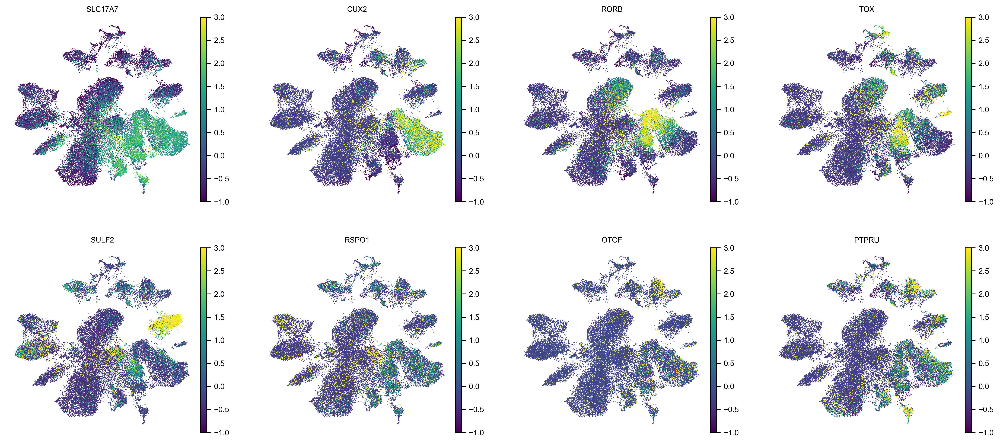

In [30]:
sc.pl.umap(merged_adata, color=['SLC17A7','CUX2','RORB', 'TOX', 'SULF2', 'RSPO1', 'OTOF','PTPRU'],
           vmin=-1, vmax=3, save='_excitatory_gene.png')

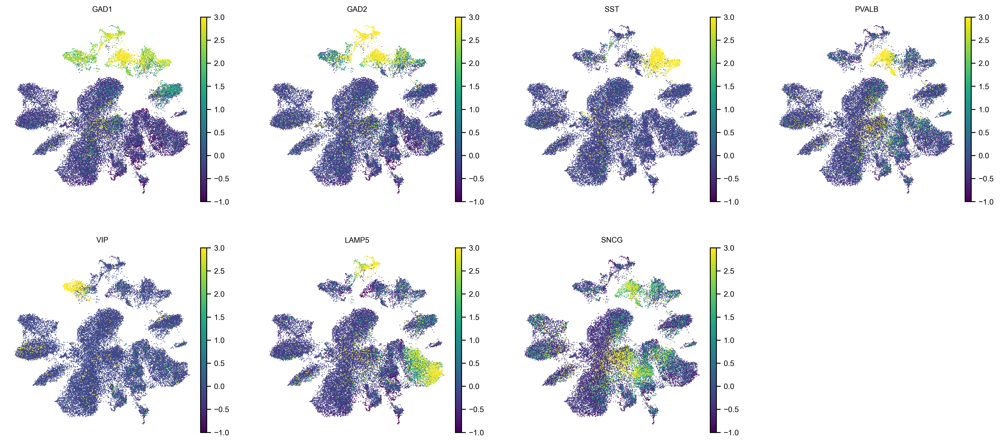

In [31]:
sc.pl.umap(merged_adata, color=['GAD1','GAD2','SST','PVALB','VIP','LAMP5','SNCG'],
           vmin=-1, vmax=3, save='_inhibitory_gene.png')

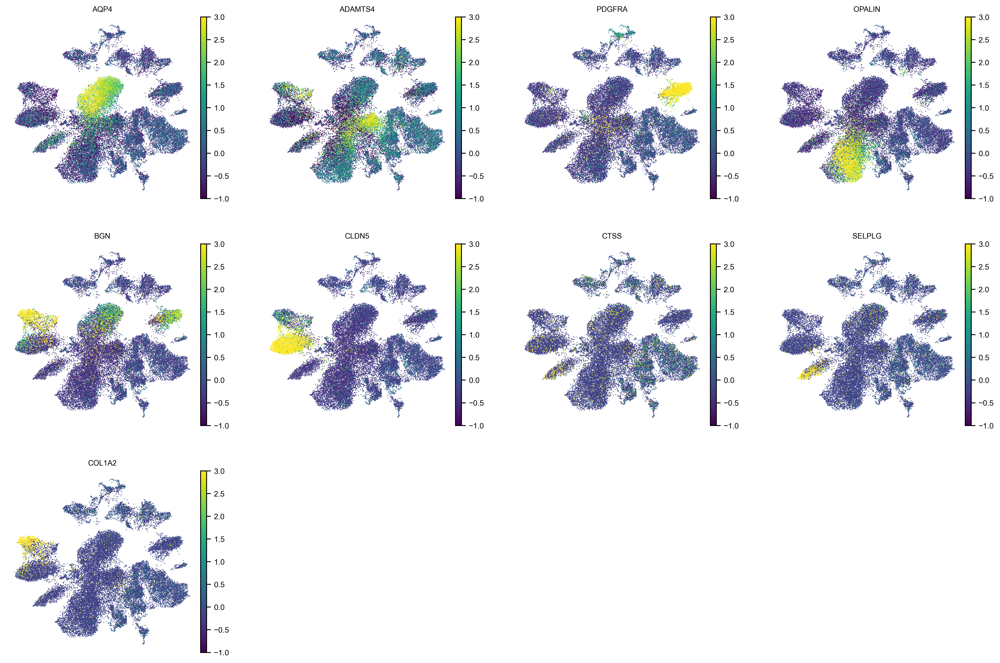

In [32]:
sc.pl.umap(merged_adata, color=['AQP4','ADAMTS4','PDGFRA','OPALIN','BGN','CLDN5', 'CTSS', 'SELPLG','COL1A2'],
           vmin=-1, vmax=3, save='_nonneuron_gene.png')

In [33]:
experiments = list(np.unique(merged_adata.obs['experiment']))
print(experiments)

['20221023', '20221025', '20221026']


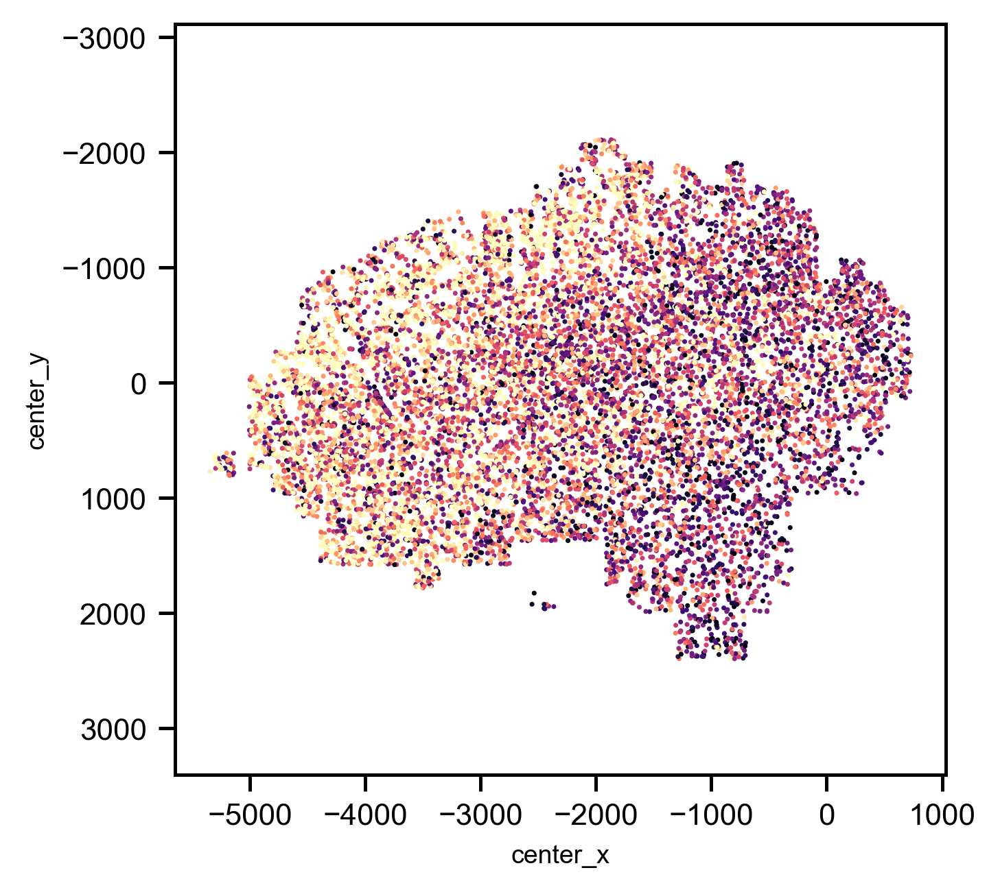

In [35]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
sel_experiment_id = 2
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     hue='total_counts', hue_norm=LogNorm(vmin=10,vmax=200), 
                     palette='magma',
                     s=2, linewidth=0,
                     legend=False, )
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
#ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial-total_counts_{experiments[sel_experiment_id]}.png'), 
            transparent=True)
plt.show()

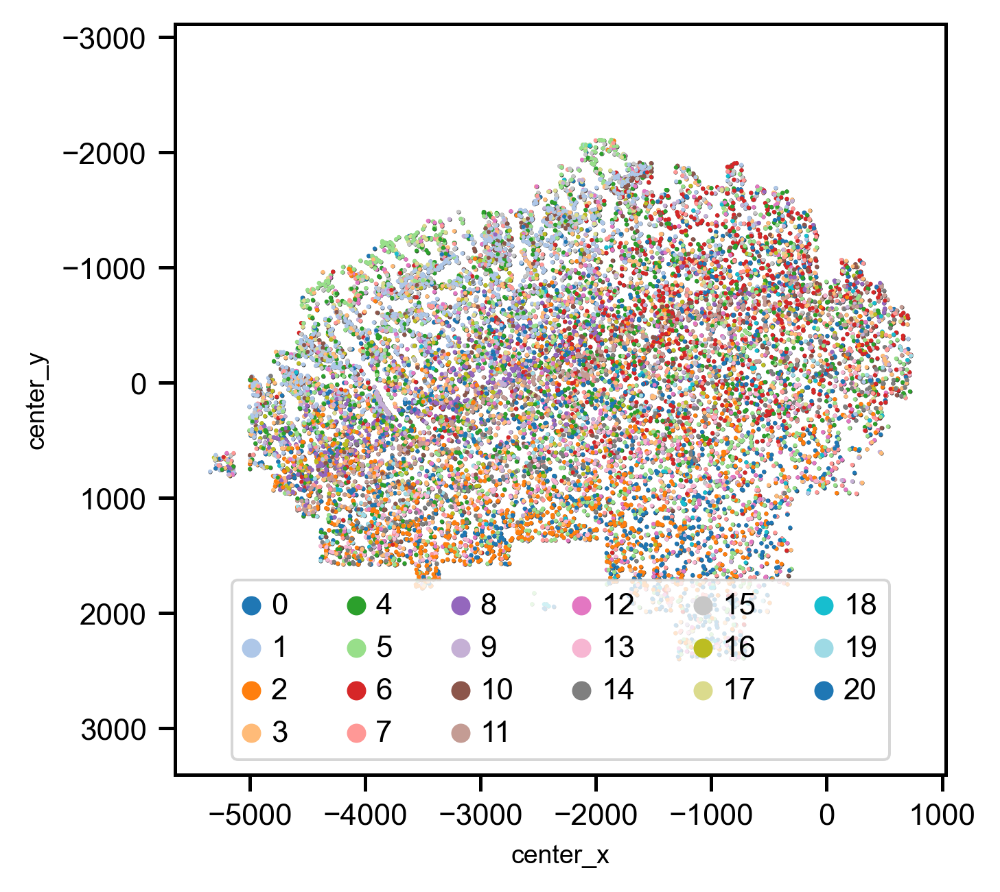

In [36]:
import matplotlib.pyplot as plt
# visualzie the spatial dist for clusters
sel_clusters = np.unique(sel_obs['leiden_cluster'])

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if _cls in sel_clusters]
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden', s=1.5, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8)

plt.savefig(os.path.join(figure_folder, f'spatial-all_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

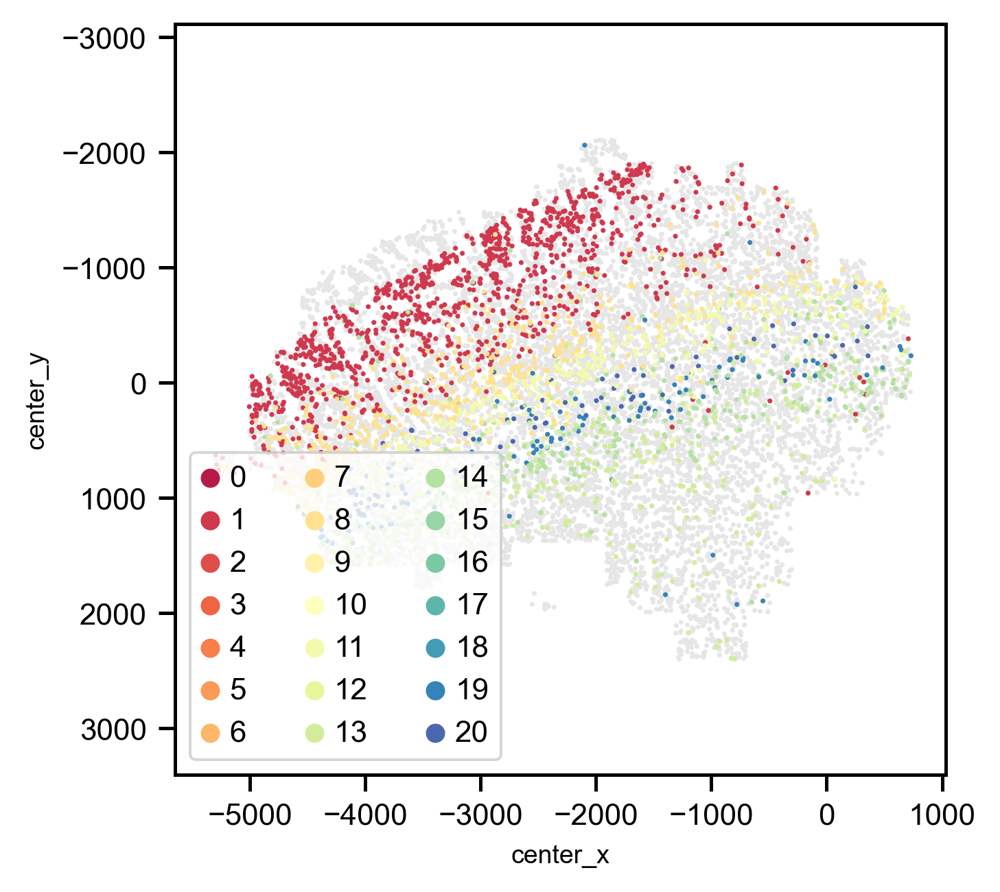

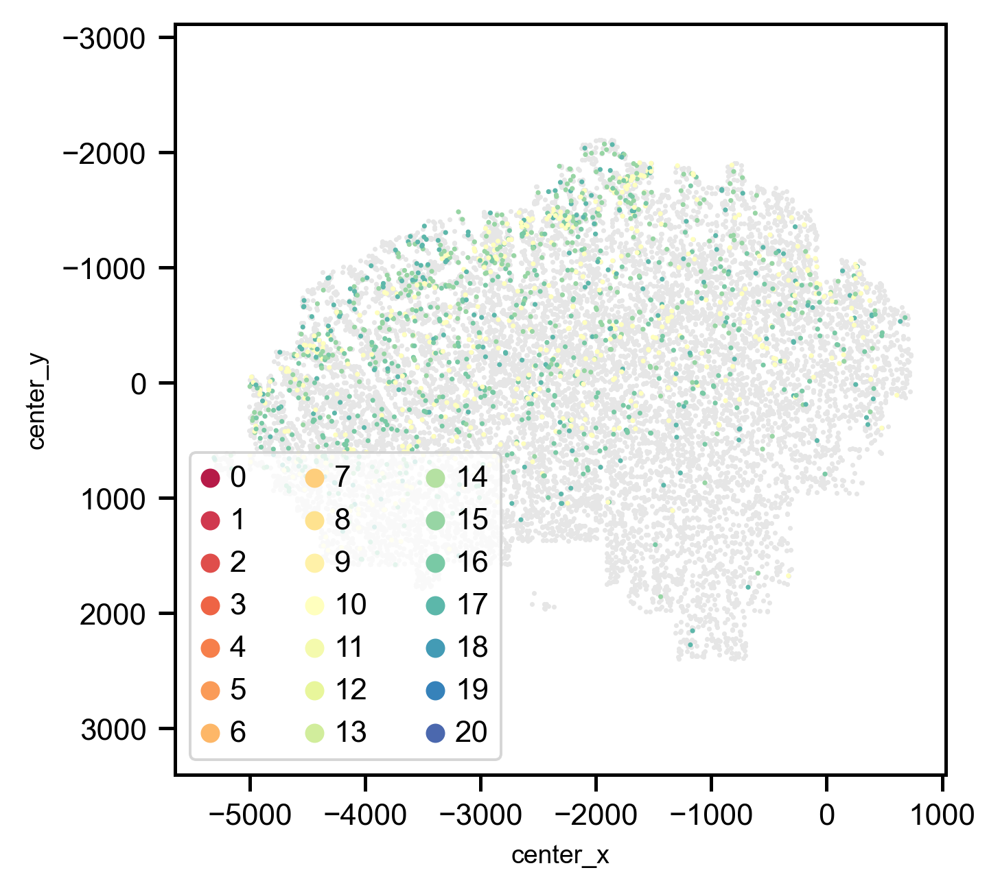

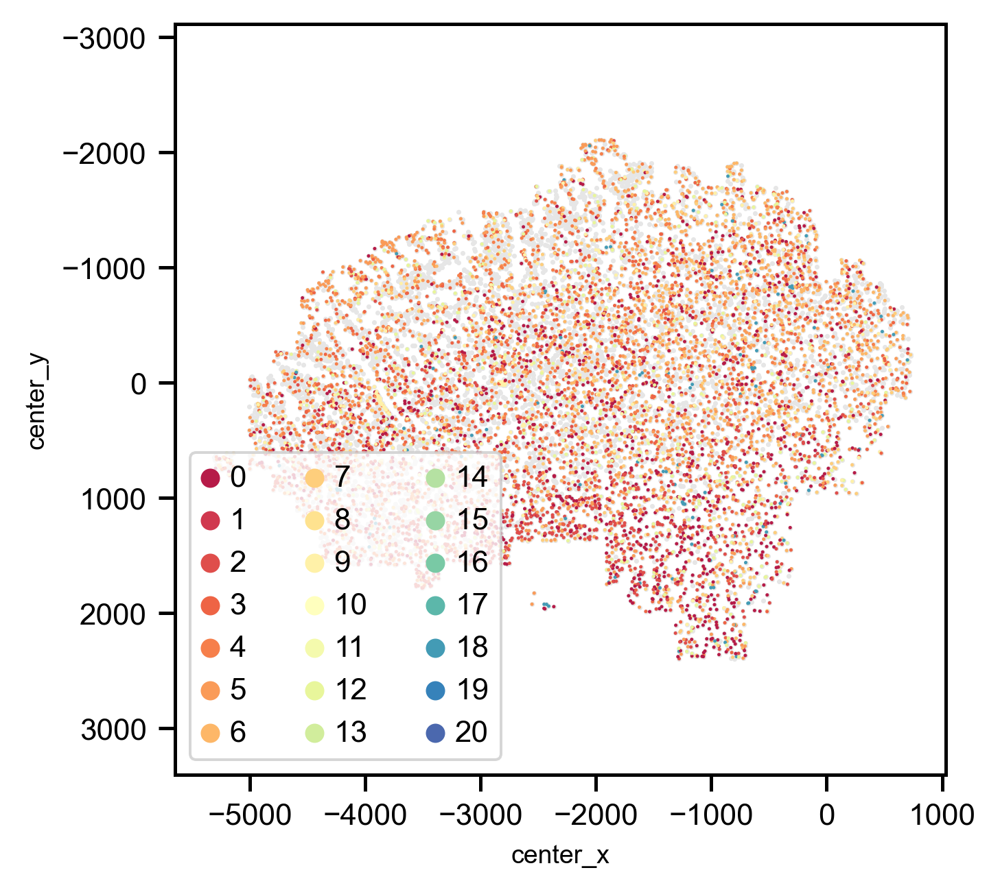

In [41]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [42]:
sel_experiment_id = 0
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

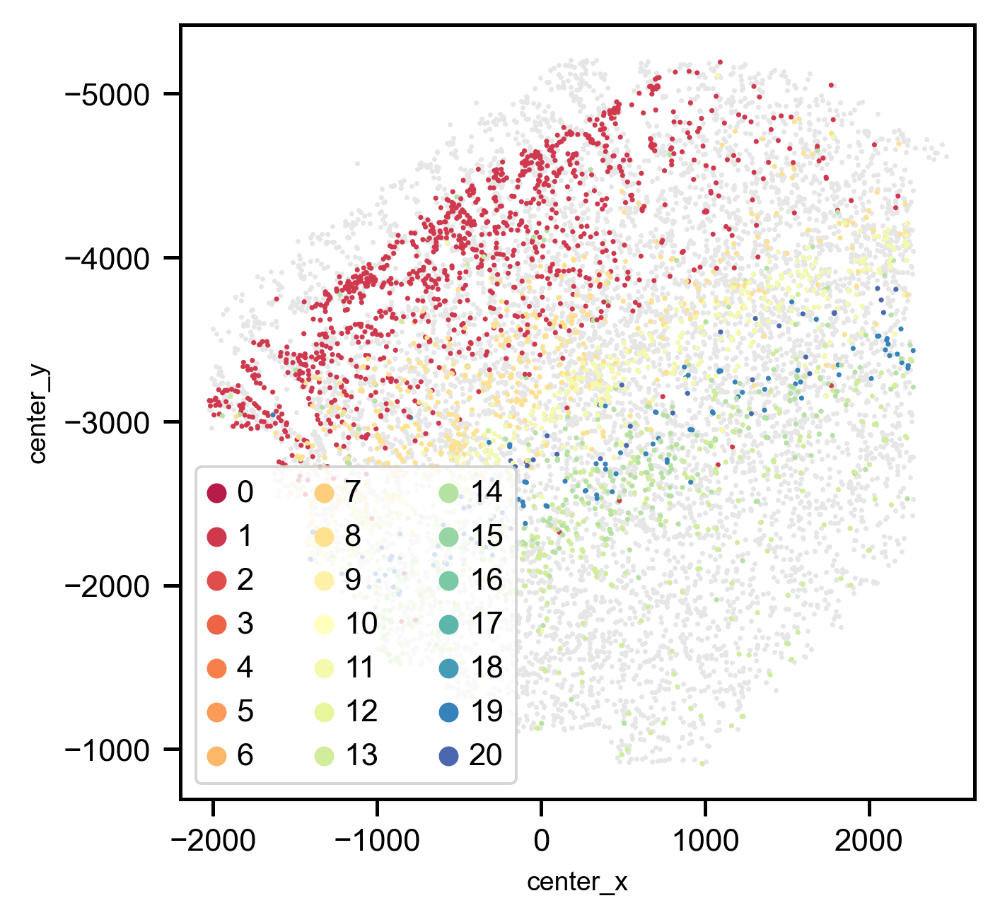

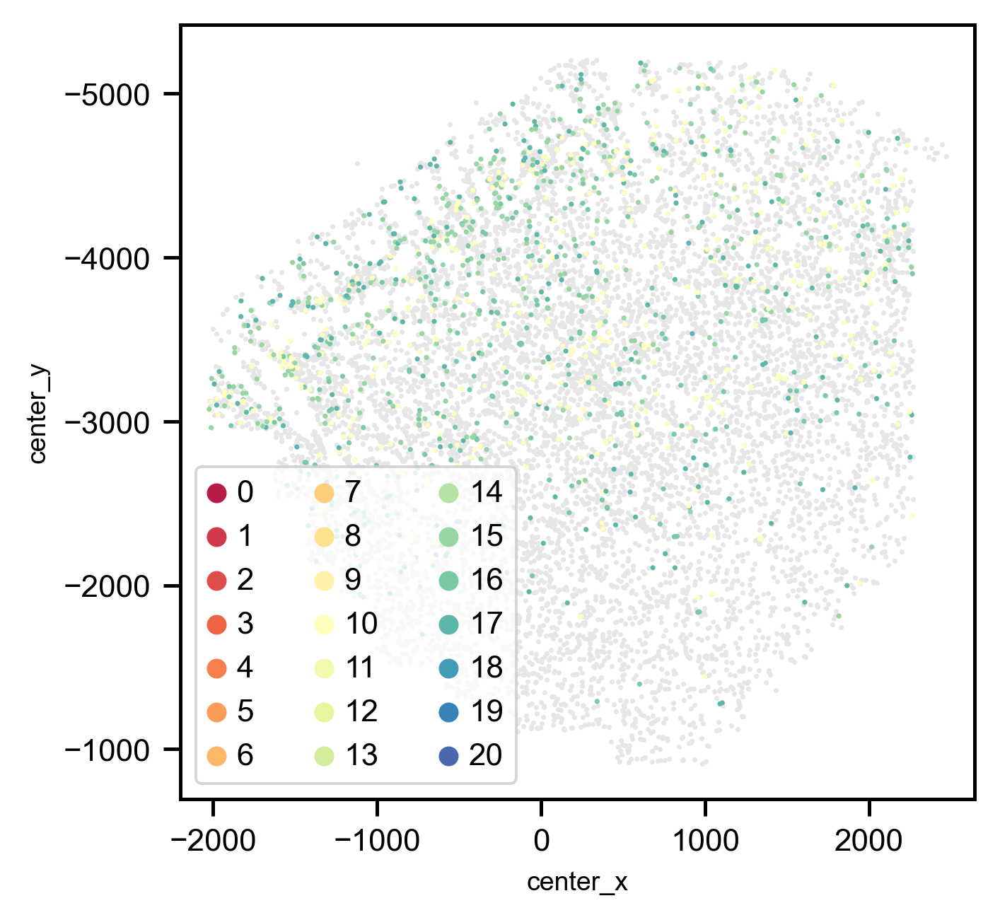

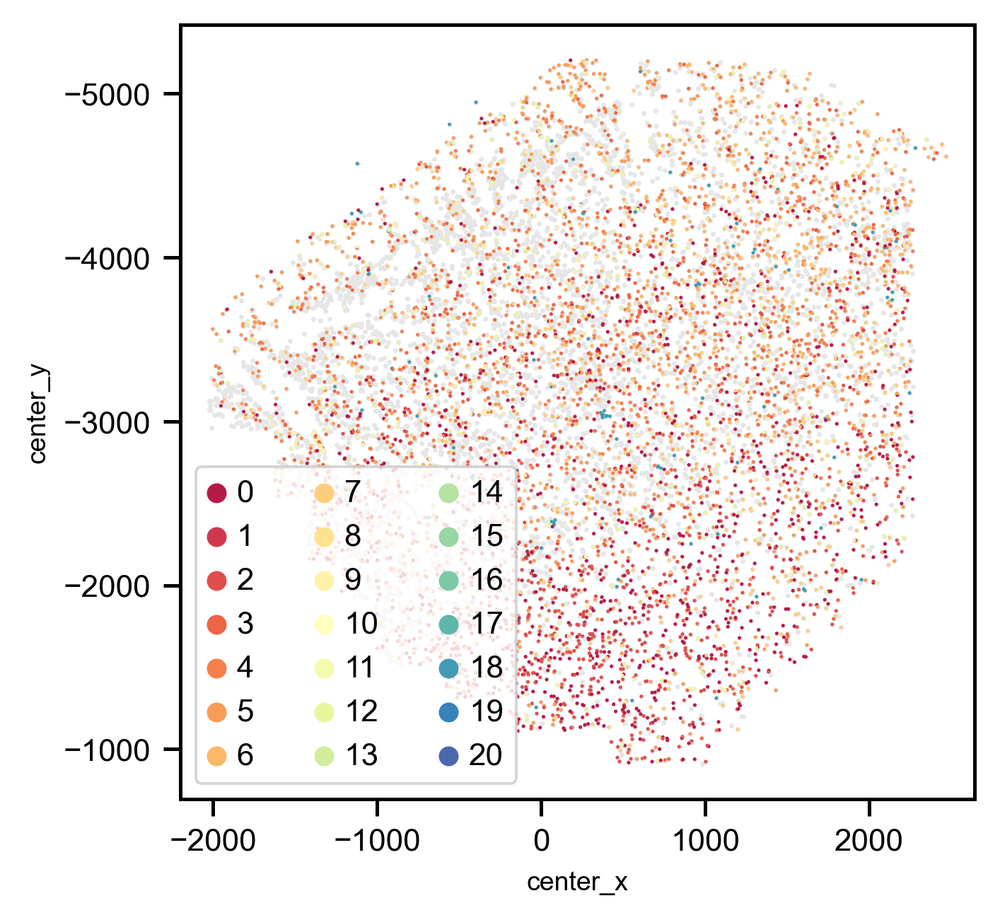

In [43]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [44]:
sel_experiment_id = 1
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

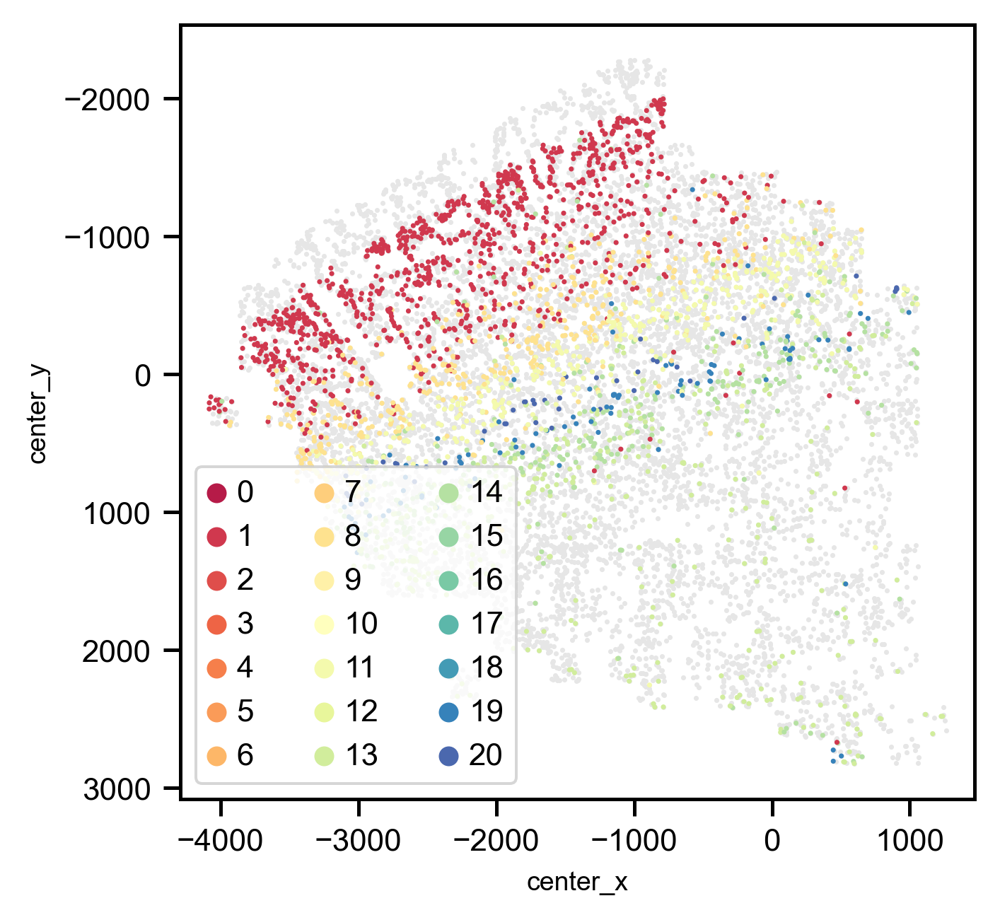

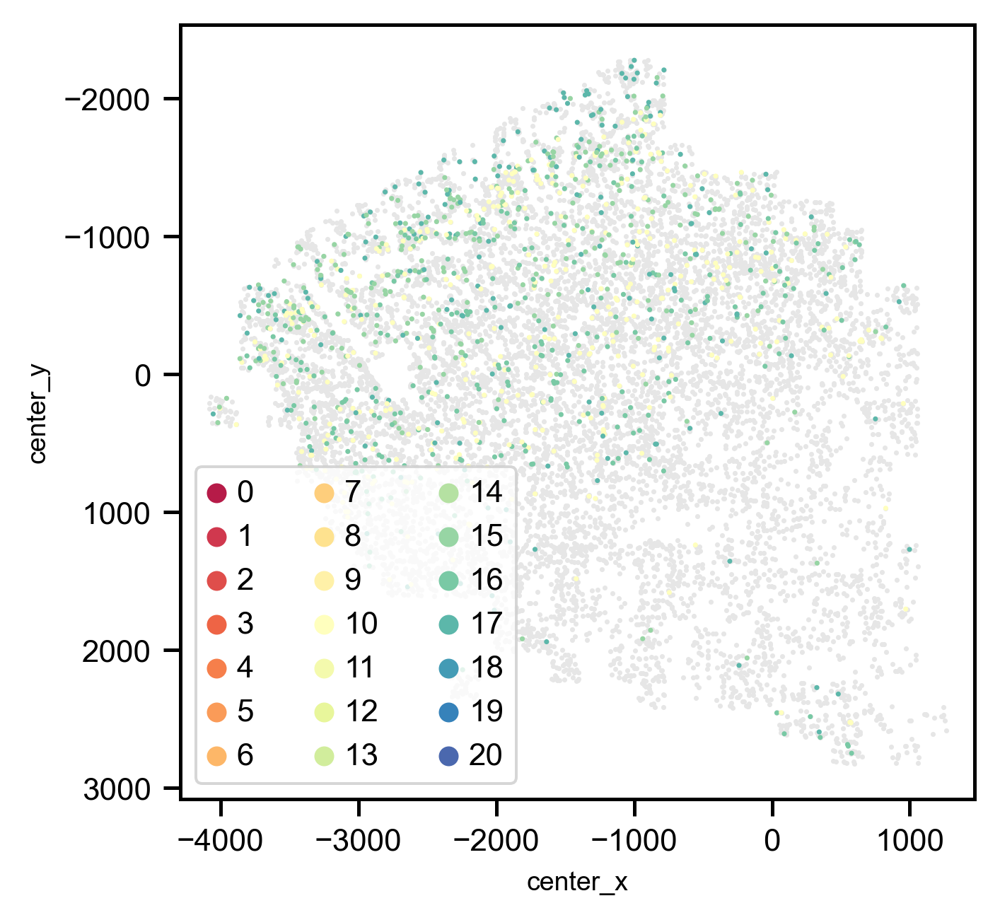

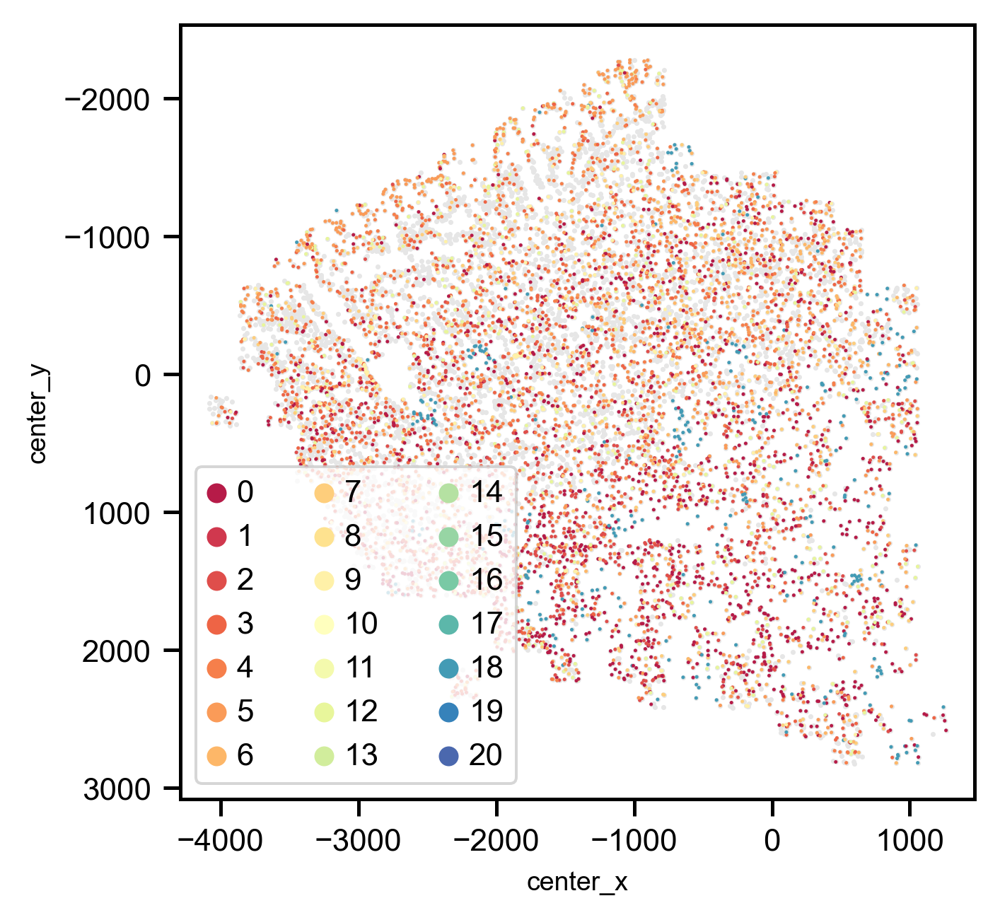

In [45]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [71]:
save_folder = os.path.join(merlin_output_master_folder, 'hM1_hM1_summary')
print(f"save_folder is: {save_folder}")
if not os.path.exists(save_folder):
    os.makedirs(save_folder)
    
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save_folder is: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary
save adata into file: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary\filtered_cluster_data.h5ad


# Run classifier

## cleanup downloaded data

downloaded from:
https://portal.brain-map.org/atlases-and-data/rnaseq/human-m1-10x


In [79]:
#
overwrite = True
seq_ref_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1'
# adata file
sel_seq_adata_filename = os.path.join(seq_ref_folder, '10x_raw.h5ad')

if os.path.exists(sel_seq_adata_filename) and not overwrite:
    print(f"Directly load adata from: {sel_seq_adata_filename}")
    m1_10x_adata = sc.read(sel_seq_adata_filename)
else:
    print(f"Assembling adata from folder: {seq_ref_folder}")
    pass
    

Assembling adata from folder: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1


In [113]:
sel_count_filename = os.path.join(seq_ref_folder, 'sel_counts.csv')
overwrite = True
if not os.path.exists(sel_count_filename) or overwrite:
    print(sel_count_filename)
    
    # generate sel_counts:
    m1_seq_df = pd.read_csv(r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1\matrix.csv', low_memory=False)

    gene_list = list(merged_adata.var.index)

    matched_genes = []
    for _gene in m1_seq_df.columns[1:]:
        if _gene in gene_list:
            matched_genes.append(_gene)

    count_df = m1_seq_df.set_index('sample_name')

    sel_count_df = count_df[matched_genes]
    #sel_count_df
    sel_count_df.to_csv(sel_count_filename, index=True, header=True)
else:
    print(f"file: {sel_count_filename} already exists, load.")
    sel_count_df = pd.read_csv(sel_count_filename)

\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1\sel_counts.csv


In [114]:
sel_count_df

,CD52,PTPRU,MARCKSL1,RSPO1,POU3F1,RAB3B,ROR1,PTGER3,SLC44A5,ST6GALNAC5,...,CHODL,CLDN5,TIMP3,PVALB,SOX10,WNT7B,NHS,PCDH11X,IL1RAPL2,BGN
sample_name,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGGATTTCC-LKTX_190129_01_A01,0,2,0,0,0,2,0,0,18,9,...,0,0,0,0,0,0,1,7,0,0
AAACCCAAGTATGGCG-LKTX_190129_01_A01,0,0,1,0,0,1,0,0,2,12,...,0,0,0,0,0,0,0,7,0,0
AAACCCACAAAGTGTA-LKTX_190129_01_A01,0,0,0,0,0,0,0,0,9,3,...,0,0,0,0,0,0,0,11,34,0
AAACCCACACTACTTT-LKTX_190129_01_A01,0,0,0,0,0,0,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
AAACCCACAGTGAGCA-LKTX_190129_01_A01,0,0,2,0,0,1,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGATGGCGT-LKTX_190130_01_H01,0,0,2,0,0,0,0,0,0,0,...,1,0,0,0,1,0,0,0,0,0
TTTGTTGCACAGCCAC-LKTX_190130_01_H01,0,0,0,0,0,0,0,0,19,27,...,0,0,0,0,0,0,1,4,51,0
TTTGTTGCAGAGACTG-LKTX_190130_01_H01,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,1,0


In [117]:
m1_10x_save_filename = os.path.join(seq_ref_folder, 'selected_hM1_10x_raw.h5ad')
overwrite = False
if not os.path.exists(m1_10x_save_filename) or overwrite:
    # load metadata
    metadata_df = pd.read_csv(os.path.join(seq_ref_folder, 'metadata.csv'), low_memory=False)#.set_index('sample_name')
    # assemble adata
    m1_10x_adata = sc.AnnData(sel_count_df, dtype=np.float32)
    m1_10x_adata.obs = m1_10x_adata.obs.merge(metadata_df, left_index=True, right_on='sample_name').set_index('sample_name')
    print(f"Saving to file: {m1_10x_save_filename}")
    m1_10x_adata.write(m1_10x_save_filename)
else:
    print(f"Loading from file: {m1_10x_save_filename}")
    m1_10x_adata = sc.read(m1_10x_save_filename)
    

Loading from file: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1\selected_hM1_10x_raw.h5ad


# MLP

In [67]:
import torch

In [179]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as utils_data
from torch.autograd import Variable
import torch.optim as optim
#cell_by_gene = Variable(torch.Tensor(x.values))

In [118]:
getattr(F, 'relu')

<function torch.nn.functional.relu(input: torch.Tensor, inplace: bool = False) -> torch.Tensor>

In [300]:
mnist = torchv

<function torch.nn.functional.binary_cross_entropy(input: torch.Tensor, target: torch.Tensor, weight: Optional[torch.Tensor] = None, size_average: Optional[bool] = None, reduce: Optional[bool] = None, reduction: str = 'mean') -> torch.Tensor>

In [346]:
class MLP_classifier(nn.Module):
    """MLP classfier"""
    def __init__(self, n_inputs, hidden_size, n_classes):
        super().__init__()
        # self params
        self.hidden_size = hidden_size
        self.n_classes = n_classes
        # Create fully connected layers
        self.l1 = nn.Linear(n_inputs, hidden_size)
        self.l2 = nn.Linear(hidden_size, hidden_size)
        self.l3 = nn.Linear(hidden_size, n_classes)
        
    def forward(self, x, activation_func='relu', classification_func='log_softmax'):
        """Apply these layers """
        _activation_func = getattr(F, activation_func)
        _classification_func = getattr(F, classification_func)
        # x = x.view(-1, n_inputs)
        x = _activation_func(self.l1(x))
        x = _activation_func(self.l2(x))
        x = _activation_func(self.l3(x))
        x = _classification_func(x, dim=1)
        return x

In [404]:
subclass_ints = np.array([subclas_2_int[_c] for _c in m1_10x_adata.obs['subclass_label']], dtype=np.int32)

targets = Variable(torch.Tensor(subclass_ints[:,np.newaxis]))

In [420]:
torch.cuda.empty_cache()

In [411]:
torch.tensor(subclass_ints, dtype=torch.long)

tensor([16,  5,  4,  ...,  2, 13, 14])

In [425]:
n_classes = len(np.unique(m1_10x_adata.obs['subclass_label'].to_list()))

subclas_2_int = {
    _c:_i for _i, _c in enumerate(np.unique(m1_10x_adata.obs['subclass_label'].to_list()))
}
subclass_ints = np.array([subclas_2_int[_c] for _c in m1_10x_adata.obs['subclass_label']], dtype=np.int32)

device = torch.device('cuda:0')

pred_model = MLP_classifier(len(m1_10x_adata.var), 256, n_classes, ).to(device)

RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call,so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.

In [416]:
inputs = Variable(torch.tensor(m1_10x_adata.X))
#targets = Variable(torch.Tensor(subclass_ints))
targets = Variable(torch.tensor(subclass_ints[:,np.newaxis], dtype=torch.long))
training_samples = utils_data.TensorDataset(inputs, targets)

data_loader_trn = utils_data.DataLoader(training_samples, batch_size=200, drop_last=False, shuffle=True)

In [417]:
train_mlpc(pred_model, data_loader_trn, num_epoch=50, learing_rate=1e-2, loss_func='CrossEntropyLoss')

RuntimeError: 0D or 1D target tensor expected, multi-target not supported

In [401]:
torch.tensor(m1_10x_adata.obs['subclass_label'].to_numpy())

TypeError: can't convert np.ndarray of type numpy.object_. The only supported types are: float64, float32, float16, complex64, complex128, int64, int32, int16, int8, uint8, and bool.

In [414]:
pred_model.n_classes

1

In [415]:
def train_mlpc(model, train_loader, optimizer='Adam', loss_func='MSELoss', 
               learing_rate=1e-3, num_epoch=256, device=None):
    
    model.train()
    
    _optimizer = getattr(optim, optimizer)(model.parameters(), lr=learing_rate)
    _loss_func = getattr(nn, loss_func)()
    # default device
    if device == None:
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    for epoch in range(num_epoch):
        # init loss
        total_loss = 0.
        n_total = 0.
        n_correct = 0.
        # loop
        for _batch_ind, (data, target) in enumerate(train_loader):
            #print(_batch_ind)
            _tr_x, _tr_y = data.to(device), target.to(device)
            _pred = model(_tr_x)
            _loss = _loss_func(_pred, F.one_hot(_tr_y, model.n_classes).float() )
            #print(_loss)
            total_loss += _loss
            # init grad
            _optimizer.zero_grad()
            # propagate backward
            _loss.backward()
            # optimize parameters
            _optimizer.step()
            
            # pred
            n_total += _tr_y.size(0)
            n_correct += (_pred.argmax(-1) == _tr_y).sum().item()
            #torch.sum(_pred.int() == _tr_y.int()).detach().item()
            
        if epoch % 5 == 0:
            print (f'Epoch [{epoch+1}/{num_epoch}], Loss: {total_loss:.4f}, Accuracy: {n_correct/n_total:.4f}')
            #print(torch.max(model.l1.weight))
def test_mlpc(model, test_loader):
    pass

In [236]:
type(targets[:10].int().size(0))

int

10

In [ ]:
def pred_mlpc(model, )

In [69]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as utils_data
from torch.autograd import Variable

inputs = Variable(torch.Tensor(x.values))
targets = Variable(torch.Tensor(y.values))

class MLP(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, output_size)
        
    def forward(self, x):
        out = self.fc2(F.relu(self.fc1(x)))
        return out

input_size = inputs.size()[1]
hidden_size = 100
output_size = 1
num_epoch = 200
learning_rate = 1e-3

model = MLP(input_size = input_size, hidden_size = hidden_size,
            output_size = output_size)

optimizer = torch.optim.Adam(model.parameters(), lr = learning_rate, weight_decay=1e-4)
loss_fct = nn.MSELoss()

training_samples = utils_data.TensorDataset(inputs, targets)
data_loader_trn = utils_data.DataLoader(training_samples, batch_size=200, drop_last=False, shuffle=True)

#train
for epoch in range(num_epoch):
        cum_loss = 0
        for batch_idx, (data, target) in enumerate(data_loader_trn):

            tr_x, tr_y = data.float(), target.float()

            pred = model(tr_x)
            loss = loss_fct(pred, tr_y)
        
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            cum_loss += loss.item()
            
        if epoch % 10 == 0:
            print ('Epoch [%d/%d], Loss: %.4f' 
                      %(epoch+1, num_epoch, cum_loss))


final_prediction = model(inputs)
final_pred_np = final_prediction.clone().detach().numpy()

np.corrcoef(final_pred_np.squeeze(), targets)[0,1]

In [104]:
m1_10x_adata.var

""
CD52
PTPRU
MARCKSL1
RSPO1
POU3F1
...
WNT7B
NHS
PCDH11X
IL1RAPL2
